# SPADE GAN XRAYs

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import os
from torchvision.utils import save_image
from cleanfid import fid

In [2]:
#!pip install clean-fid

In [3]:
epochs = 80
loss_g_per_batch = []
loss_d_per_batch = []
loss_g = []
loss_d = []
real_score_per_batch = []
fake_score_per_batch = []
real_score = []
fake_score = []
for i in range(1, epochs+1):
    loss_g_per_batch = np.concatenate([loss_g_per_batch, np.genfromtxt('logs/loss_g_per_batch_%d_epoch.txt' %i)])
    loss_d_per_batch = np.concatenate([loss_d_per_batch, np.genfromtxt('logs/loss_d_per_batch_%d_epoch.txt' %i)])
    loss_g = np.concatenate([loss_g, [np.genfromtxt('logs/losses_g_%d_epoch.txt' %i)]])
    loss_d = np.concatenate([loss_d, [np.genfromtxt('logs/losses_d_%d_epoch.txt' %i)]])
    real_score_per_batch = np.concatenate([real_score_per_batch, np.genfromtxt('logs/real_score_per_batch_%d_epoch.txt' %i)])
    fake_score_per_batch = np.concatenate([fake_score_per_batch, np.genfromtxt('logs/fake_score_per_batch_%d_epoch.txt' %i)])
    real_score = np.concatenate([real_score, [np.genfromtxt('logs/real_scores_%d_epoch.txt' %i)]])
    fake_score = np.concatenate([fake_score, [np.genfromtxt('logs/fake_scores_%d_epoch.txt' %i)]])

In [4]:
x_batch=np.arange(1,loss_g_per_batch.shape[0]+1)
x = np.arange(1,loss_g.shape[0]+1)

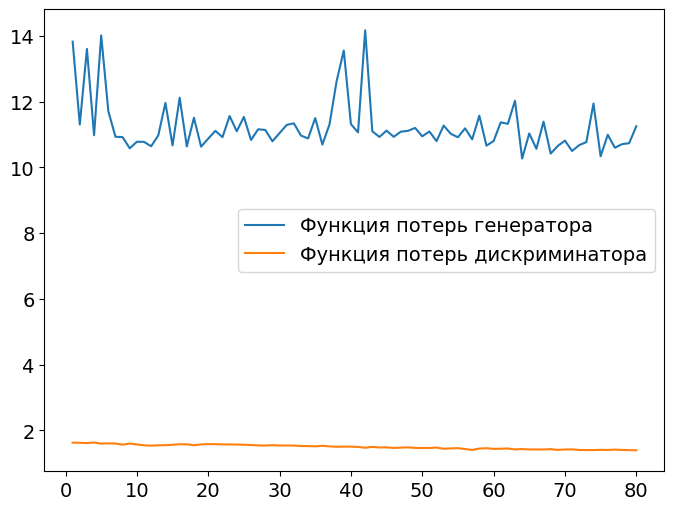

In [6]:
plt.figure(figsize=(8,6))
plt.rcParams.update({'font.size': 14})

plt.plot(x, loss_g, label='Функция потерь генератора')
plt.plot(x, loss_d, label='Функция потерь дискриминатора')
plt.legend()

plt.show()

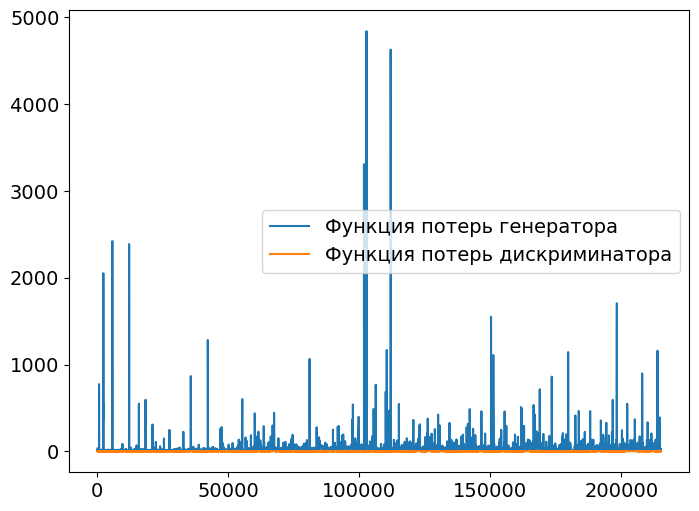

In [7]:
plt.figure(figsize=(8,6))
plt.rcParams.update({'font.size': 14})

plt.plot(x_batch, loss_g_per_batch, label='Функция потерь генератора')
plt.plot(x_batch, loss_d_per_batch, label='Функция потерь дискриминатора')
plt.legend()

plt.show()

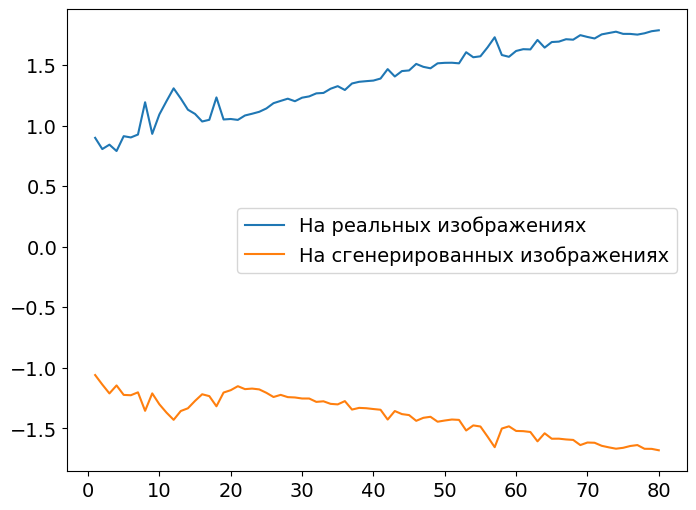

In [8]:
plt.figure(figsize=(8,6))
plt.rcParams.update({'font.size': 14})

plt.plot(x, real_score, label='На реальных изображениях')
plt.plot(x, fake_score, label='На сгенерированных изображениях')
plt.legend()

plt.show()

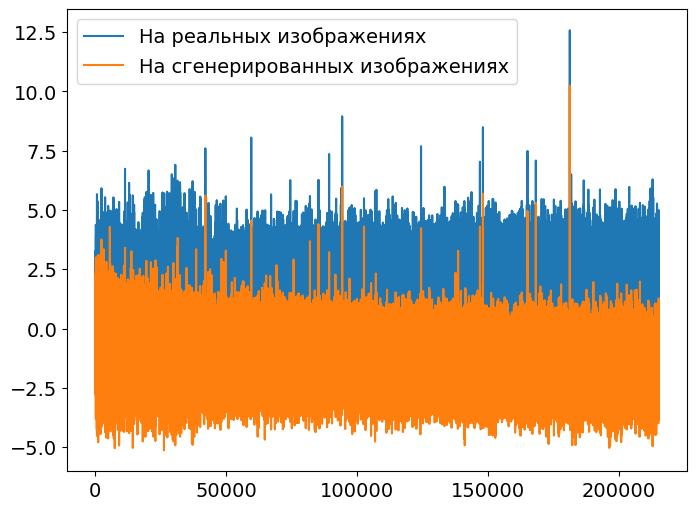

In [9]:
plt.figure(figsize=(8,6))
plt.rcParams.update({'font.size': 14})

plt.plot(x_batch, real_score_per_batch, label='На реальных изображениях')
plt.plot(x_batch, fake_score_per_batch, label='На сгенерированных изображениях')
plt.legend()

plt.show()

In [3]:
import warnings
warnings.filterwarnings('ignore')

import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt
import PIL
from tqdm import tqdm
from torchsummary import summary
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
import torch.nn.utils.spectral_norm as spectral_norm
import torch.nn.functional as F
import functools
from torch.nn.parallel import DistributedDataParallel as DDP
from torchvision.utils import save_image

img_size = 256

img_channels = 1
n_channels = 1
seg_map_channels = 1

step_channels = 64
latent_size = 256

batch_size = 12

beta1 = 0.0 
beta2 = 0.999

lr={
    'generator': 0.0001,
    'discriminator': 0.0004
}

lambda_kld = 0.05 # weight for KLDLoss
lambda_feat = 10.0 # weight for feature matching loss 

num_workers = 4

EPOCH_START = 80

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
DATA_PATH = 'E:/Notebooks/Course_project_and_diploma/datasets/pix2pix_dataset'

class Split(object):
    def __call__(self, image):
        return image[2,:,:].view(1,img_size,img_size),image[1,:,:].view(1,img_size,img_size)
    


dataset = ImageFolder(DATA_PATH, transform=transforms.Compose([
        transforms.Resize(img_size,interpolation=transforms.InterpolationMode.LANCZOS),
        transforms.ToTensor(),
        transforms.Normalize(mean=(0.5,0.5,0.5), std=(0.5,0.5,0.5)),
        Split()
        ]))
dataloader = DataLoader(dataset, batch_size, shuffle=True, num_workers=num_workers)


class SPADE(nn.Module):
    def __init__(self, norm_nc, label_nc):
        super(SPADE, self).__init__()
        
        self.norm = nn.BatchNorm2d(norm_nc, affine = False)
        
        nhidden = 128
        self.shared = nn.Sequential(
            nn.Conv2d(label_nc, nhidden, kernel_size=3, padding=1),
            nn.ReLU()
        )
        self.gamma = nn.Conv2d(nhidden, norm_nc, kernel_size=3, padding=1)
        self.beta = nn.Conv2d(nhidden, norm_nc, kernel_size=3, padding=1)
        
    def forward(self, x, segmap):
        
        normalized = self.norm(x)
        
        segmap = F.interpolate(segmap, size = x.size()[2:], mode='nearest')
        act = self.shared(segmap)
        gamma = self.gamma(act)
        beta = self.beta(act)
        
        out = normalized * (1 + gamma) + beta
        
        return out

class SPADEResnetBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(SPADEResnetBlock, self).__init__()
        
        self.reduce_channels = (in_channels != out_channels)
        
        mid_channels = min(in_channels, out_channels)
        self.conv_0 = spectral_norm(nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1))
        self.conv_1 = spectral_norm(nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1))
        if self.reduce_channels:
            self.conv_s = spectral_norm(nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=False))
        
        self.norm_0 = SPADE(in_channels, seg_map_channels)
        self.norm_1 = SPADE(mid_channels, seg_map_channels)
        if self.reduce_channels:
            self.norm_s = SPADE(in_channels, seg_map_channels)
            
        self.act = nn.LeakyReLU(0.2)
        
    def forward(self, x, seg):
        
        if self.reduce_channels:
            x_s = self.conv_s(self.norm_s(x, seg))
        else:
            x_s = x
            
        dx = self.conv_0(self.act(self.norm_0(x, seg)))
        dx = self.conv_1(self.act(self.norm_1(dx, seg)))
        
        out = x_s + dx
        
        return out

class SPADEGenerator(nn.Module):
    def __init__(self, step_channels = step_channels, latent_size = latent_size):
        super(SPADEGenerator, self).__init__()
        
        self.fc = nn.Linear(latent_size, 16 * step_channels * 4 * 4)
        
        self.head_0 = SPADEResnetBlock(16 * step_channels, 16 * step_channels)

        self.G_middle_0 = SPADEResnetBlock(16 * step_channels, 16 * step_channels)
        self.G_middle_1 = SPADEResnetBlock(16 * step_channels, 16 * step_channels)

        self.up_0 = SPADEResnetBlock(16 * step_channels, 8 * step_channels)
        self.up_1 = SPADEResnetBlock(8 * step_channels, 4 * step_channels)
        self.up_2 = SPADEResnetBlock(4 * step_channels, 2 * step_channels)
        self.up_3 = SPADEResnetBlock(2 * step_channels, 1 * step_channels)
        
        self.conv_img = nn.Conv2d(1 * step_channels, img_channels, 3, padding=1)

        self.up = nn.Upsample(scale_factor=2)
        
        self.final_act = nn.Tanh()
        self.act = nn.LeakyReLU(0.2)
        
    def forward(self, seg, z = None):
        if z is None:
            z = torch.randn(seg.size(0), latent_size, dtype=torch.float32, device = device)
            
        x = self.fc(z)
        x = x.view(-1, 16 * step_channels, 4, 4)
        x = self.head_0(x, seg)

        x = self.up(x) # 8x8
        x = self.G_middle_0(x, seg)
        x = self.up(x) # 16x16
        x = self.G_middle_1(x, seg)
        
        x = self.up(x) # 32x32
        x = self.up_0(x, seg)
        x = self.up(x) # 64x64
        x = self.up_1(x, seg)
        x = self.up(x) # 128x128
        x = self.up_2(x, seg)
        x = self.up(x) # 256x256
        x = self.up_3(x, seg)
        
        x = self.conv_img(self.act(x))
        x = self.final_act(x)
        
        return x
    

class Encoder(nn.Module):
    def __init__(self, step_channels = step_channels):
        super(Encoder, self).__init__()
        
        input_channels = img_channels
        cur_channels = step_channels
        sequence = [nn.Conv2d(input_channels, cur_channels, kernel_size = 3, stride = 2, padding = 1),
                   nn.InstanceNorm2d(cur_channels), nn.LeakyReLU(0.2)]
        for i in range(1, 6):
            prev_channels = cur_channels
            cur_channels = min(cur_channels * 2, step_channels * 8)
            sequence += [nn.Conv2d(prev_channels, cur_channels, kernel_size = 3, stride = 2, padding = 1),
                        nn.InstanceNorm2d(cur_channels), nn.LeakyReLU(0.2)]
            
        self.convs = nn.Sequential(*sequence)
            
        self.fc_mu = nn.Linear(step_channels * 8 * 4 * 4, latent_size)
        self.fc_logvar = nn.Linear(step_channels * 8 * 4 * 4, latent_size)
        
    def forward(self, x):
        x = self.convs(x)
        
        x = x.view(x.size(0), -1)
        
        mu = self.fc_mu(x)
        logvar = self.fc_logvar(x)
        
        return mu, logvar

In [ ]:
batch,_=next(iter(dataloader))
fig = plt.figure(figsize=(6, 12))
plt.axis("off")
title = ['Seg Map', 'Original image']

for j in range(4):
    for i in range(1,3):
        fig.add_subplot(4, 2, j*2+i)
        plt.imshow(batch[i-1][j][0], cmap='gray')
        plt.axis("off")
        plt.title(title[i-1])

In [38]:
generator = SPADEGenerator()
generator = generator.to(device)

encoder = Encoder()
encoder = encoder.to(device)

model = {'generator': generator, 'encoder': encoder}

In [58]:
def gen_and_show(model, epochs, gen_type = 'only_seg'):
    (segmap, real_image), _ = next(iter(dataloader))
    if gen_type == 'only_seg':
        fig = plt.figure(figsize=(20, 20))
        plt.title('Generated, masks only, %d epochs' %epochs)
        plt.axis("off")
        for i in range(4):
            for j in range(1,6):
                fig.add_subplot(4, 5, i*5+j)
                if i==0:
                    plt.imshow(np.transpose(segmap[j-1], (1,2,0)), cmap = 'gray')
                    plt.axis("off")
                else:
                    with torch.no_grad():
                        generated = generator(segmap[j-1:j].to(device))
                    plt.imshow(np.transpose(generated[0].detach().cpu(),(1,2,0)), cmap='gray')
                    plt.axis("off")
        plt.subplots_adjust(wspace=0.05,hspace=0.05)
        plt.show()
    else:
        fig = plt.figure(figsize=(20, 20))
        plt.axis("off")
        plt.title('Generated, masks and origs, %d epochs' %epochs)
        for i in range(6):
            for j in range(1,6):
                fig.add_subplot(6, 5, i*5+j)
                if i==0 and j==1:
                    plt.axis("off")
                    continue
                elif j==1:
                    plt.imshow(np.transpose(real_image[i-1], (1,2,0)), cmap = 'gray')
                    plt.axis("off")
                elif i==0:
                    plt.imshow(np.transpose(segmap[j-2], (1,2,0)), cmap = 'gray')
                    plt.axis("off")
                else:
                    with torch.no_grad():
                        mu, logvar = encoder(real_image[i-1:i].to(device))
                        std = torch.exp(0.5 * logvar)
                        eps = torch.randn_like(std)
                        z = eps.mul(std) + mu
                        generated = model['generator'](segmap[j-2:j-1].to(device), z)
                    plt.imshow(np.transpose(generated[0].detach().cpu(),(1,2,0)), cmap='gray')
                    plt.axis("off")
        plt.subplots_adjust(wspace=0.05,hspace=0.05)
        plt.show()

In [54]:
def gen_and_show_mask_and_origs(model, epochs,):

    (segmap, real_image), _ = next(iter(dataloader))
    
    fig = plt.figure(figsize=(20, 20))
    plt.axis("off")
    plt.title('Generated, masks and origs, %d epochs' %epochs)
    for i in range(6):
        for j in range(1,6):
            fig.add_subplot(6, 5, i*5+j)
            if i==0 and j==1:
                plt.axis("off")
                continue
            elif j==1:
                plt.imshow(np.transpose(real_image[i-1], (1,2,0)), cmap = 'gray')
                plt.axis("off")
            elif i==0:
                plt.imshow(np.transpose(segmap[j-2], (1,2,0)), cmap = 'gray')
                plt.axis("off")
            else:
                with torch.no_grad():
                    mu, logvar = encoder(real_image[i-1:i].to(device))
                    std = torch.exp(0.5 * logvar)
                    eps = torch.randn_like(std)
                    z = eps.mul(std) + mu
                    generated = model['generator'](segmap[j-2:j-1].to(device), z)
                plt.imshow(np.transpose(generated[0].detach().cpu(),(1,2,0)), cmap='gray')
                plt.axis("off")
    plt.subplots_adjust(wspace=0.05,hspace=0.05)
    plt.show()

In [62]:
def calculate_fid(model, n_images = 1000, gen_type='only_seg', rearrange = False, batch_size=64):
    if not os.path.isdir('generated'):
        os.mkdir('generated')
    else:
        if len([name for name in os.listdir('generated')]) != n_images or rearrange:
            folderPath = 'generated'
            for file in os.listdir(folderPath):
                fullFilePath = folderPath + "/" + file
                os.remove(fullFilePath)
    if len([name for name in os.listdir('generated')]) != n_images or rearrange:    
        model['generator'].eval()
        dataloader1 = DataLoader(dataset, batch_size, shuffle=True, num_workers=num_workers)
        if gen_type == 'only_seg':
            with torch.no_grad():
                for i in tqdm(range(len(dataloader1))):
                    (seg, real), _ = next(iter(dataloader1))
                    generated = model['generator'](seg.to(device))
                    for j in range(len(seg)):
                        save_image((generated[j]+1)/2., 'generated/%d.png' %(i*batch_size + j))
        else:
            model['encoder'].eval()
            dataloader2 = DataLoader(dataset, batch_size, shuffle=True, num_workers=num_workers)
            with torch.no_grad():
                for i in tqdm(range(len(dataloader1))):
                    (seg1, real1), _ = next(iter(dataloader1))
                    (seg2, real2), _ = next(iter(dataloader2))
                    mu, logvar = model['encoder'](real1.to(device))
                    std = torch.exp(0.5 * logvar)
                    eps = torch.randn_like(std)
                    z = eps.mul(std) + mu
                    generated = model['generator'](seg2.to(device), z)
                    for j in range(len(seg1)):
                        save_image((generated[j]+1)/2., 'generated/%d.png' %(i*batch_size + j))

    #if on cpu num_workers should be >0
    score = fid.compute_fid('pix2pix_xrays_1channel_only', 'generated', mode = 'clean', num_workers = 4, device = device, batch_size = batch_size)
    return score

In [29]:
def load_model(model, epoch):
    model['encoder'].load_state_dict(torch.load('weights/encoder_epoch_%d.pth' %epoch, map_location=device))
    model['generator'].load_state_dict(torch.load('weights/generator_epoch_%d.pth' %epoch, map_location=device))

In [ ]:
class Split(object):
    def __call__(self, image):
        return transforms.Grayscale(num_output_channels=n_channels)(image[1,:,:].view(n_channels,img_size,img_size))
        
DATA_PATH = '...'
dataset = ImageFolder(DATA_PATH, transform=transforms.Compose([
        transforms.Resize(img_size,interpolation=transforms.InterpolationMode.BICUBIC),
        #transforms.RandomHorizontalFlip(p=0.5),
        #transforms.Resize(upsample_transform, interpolation=transforms.InterpolationMode.BICUBIC),
        #transforms.RandomCrop((IMG_WIDTH,IMG_HEIGHT)),
        transforms.ToTensor(),
        transforms.Normalize(mean=(0.5,0.5,0.5), std=(0.5,0.5,0.5)),
        Split()
        ]))

In [ ]:
dataloader = DataLoader(dataset, batch_size=32, num_workers=4, shuffle=True)

In [ ]:
batch, _ = next(iter(dataloader))

plt.figure(figsize=(12, 12))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(make_grid(batch.to(device), padding=2, normalize=True).cpu() ,(1,2,0)))

In [ ]:
if not os.path.isdir('pix2pix_xrays_1channel_only'):
        os.mkdir('pix2pix_xrays_1channel_only')
i=0
for batch,_ in tqdm(dataloader):
    for j in range(len(batch)):
        save_image((batch[j]+1)/2., 'pix2pix_xrays_1channel_only/%d.png' % (i * 32 + j))
    i+=1

# 10 epochs

In [39]:
load_model(model, epoch = 10)

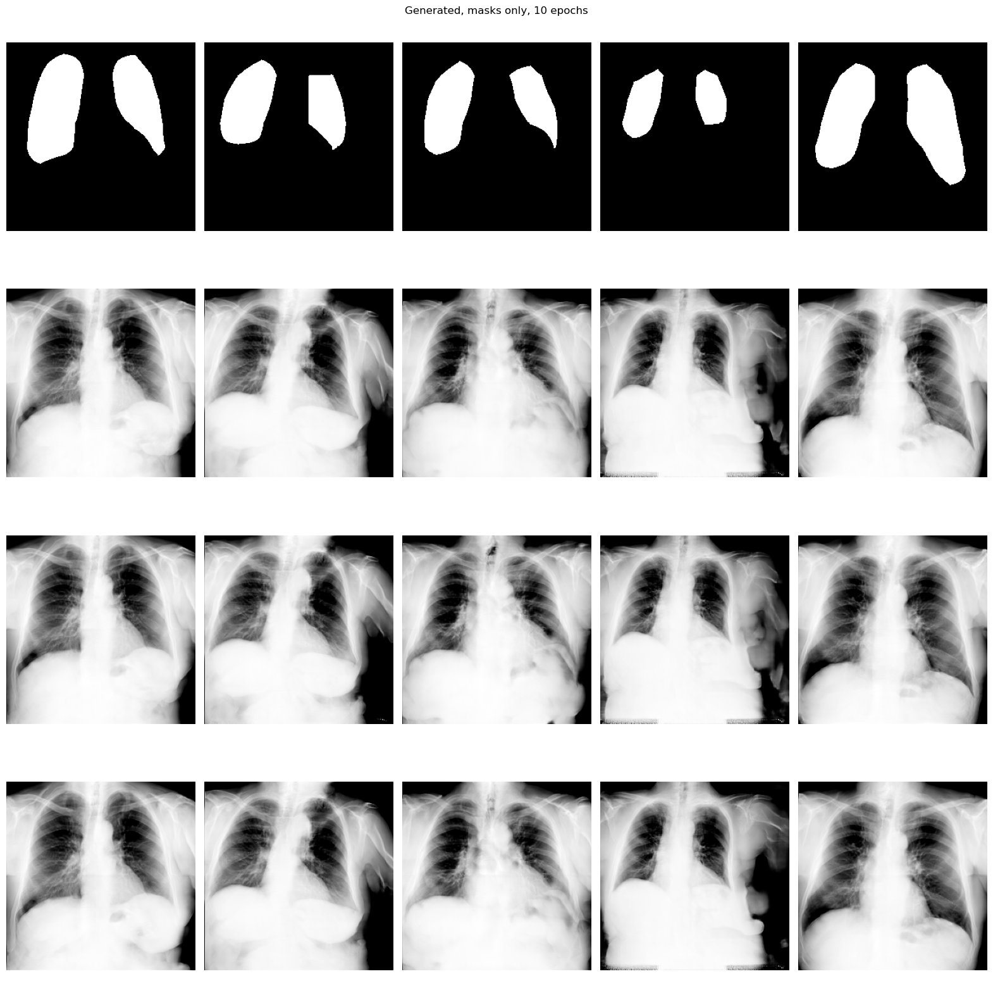

In [59]:
gen_and_show(model, epochs = 10, gen_type = 'only_seg')

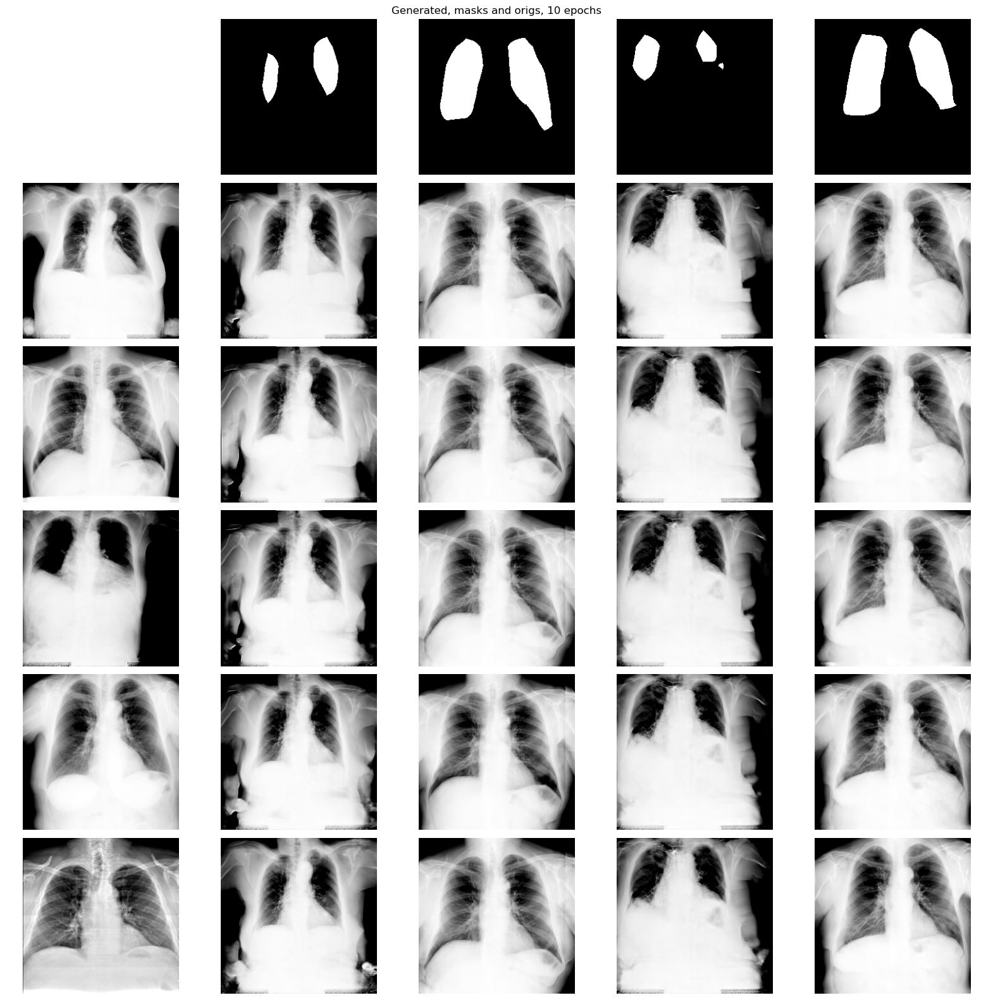

In [60]:
gen_and_show(model, epochs = 10, gen_type = 'seg_and_real')

In [ ]:
fid_10 = calculate_fid(model, n_images = len(dataset), gen_type = 'only_seg', rearrange = True, batch_size=32)

In [65]:
print(fid_10)

33.71380489181925


In [ ]:
fid_10 = calculate_fid(model, n_images = len(dataset), gen_type = 'seg_and_real', rearrange = True, batch_size=32)

In [67]:
print(fid_10)

33.1407073771328


# 20 epochs

In [68]:
load_model(model, epoch = 20)

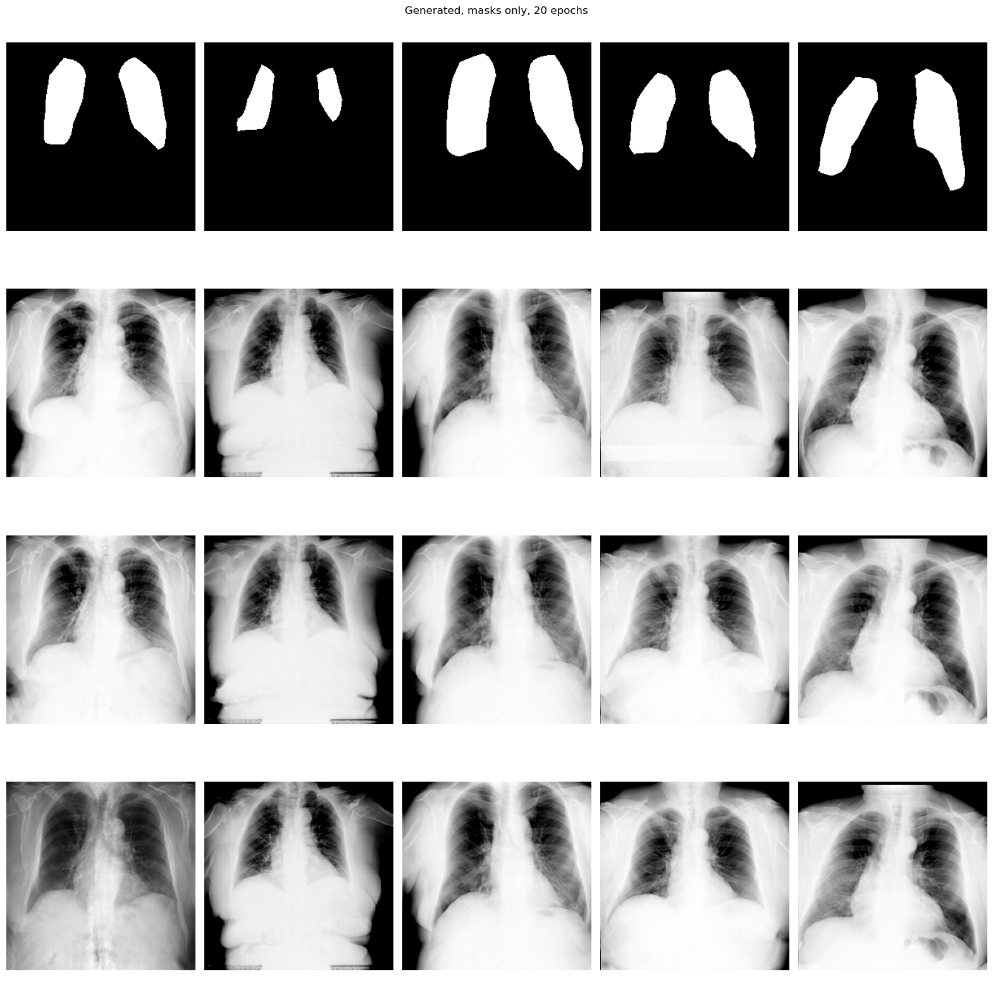

In [69]:
gen_and_show(model, epochs = 20, gen_type = 'only_seg')

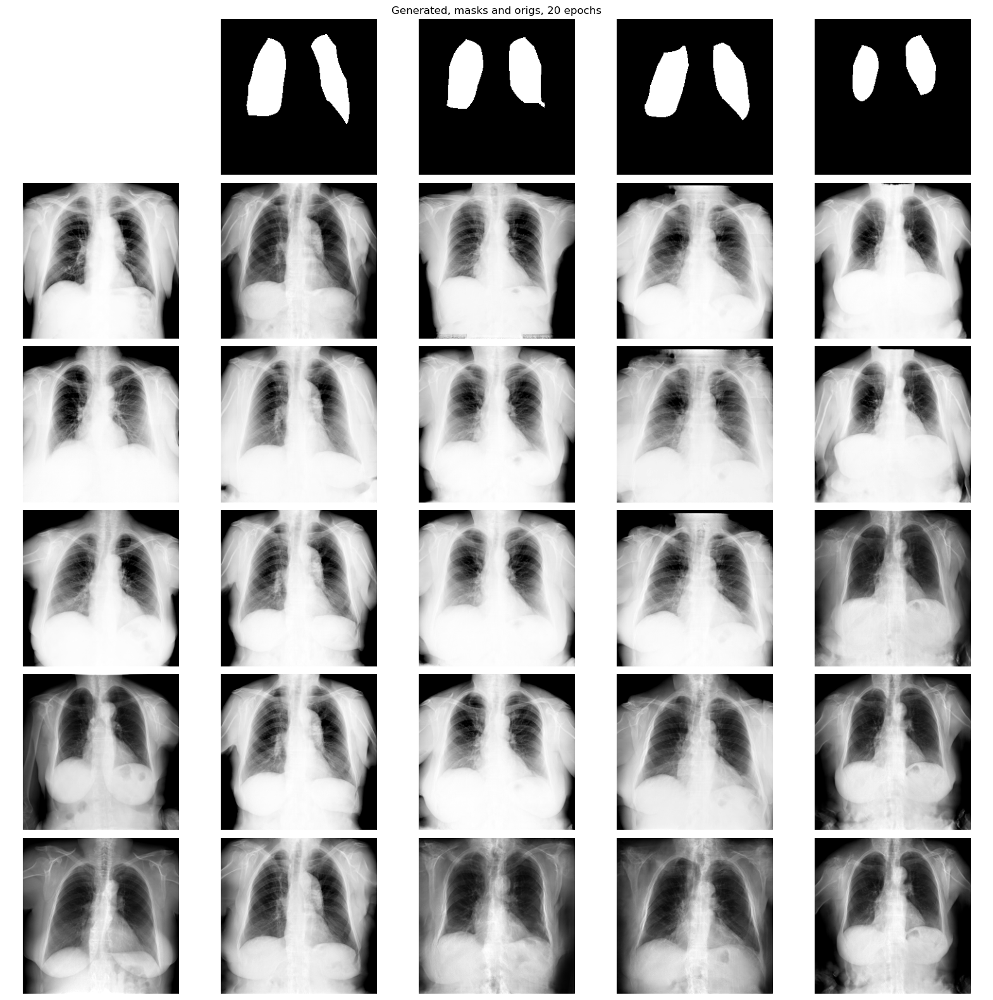

In [70]:
gen_and_show(model, epochs = 20, gen_type = 'seg_and_real')

In [ ]:
fid_20 = calculate_fid(model, n_images = len(dataset), gen_type = 'only_seg', rearrange = True, batch_size=32)

In [72]:
print(fid_20)

16.423445156154372


In [ ]:
fid_20 = calculate_fid(model, n_images = len(dataset), gen_type = 'seg_and_real', rearrange = True, batch_size=32)

In [74]:
print(fid_20)

15.265105451374382


# 30 epochs

In [75]:
epochs = 30
load_model(model, epoch = epochs)

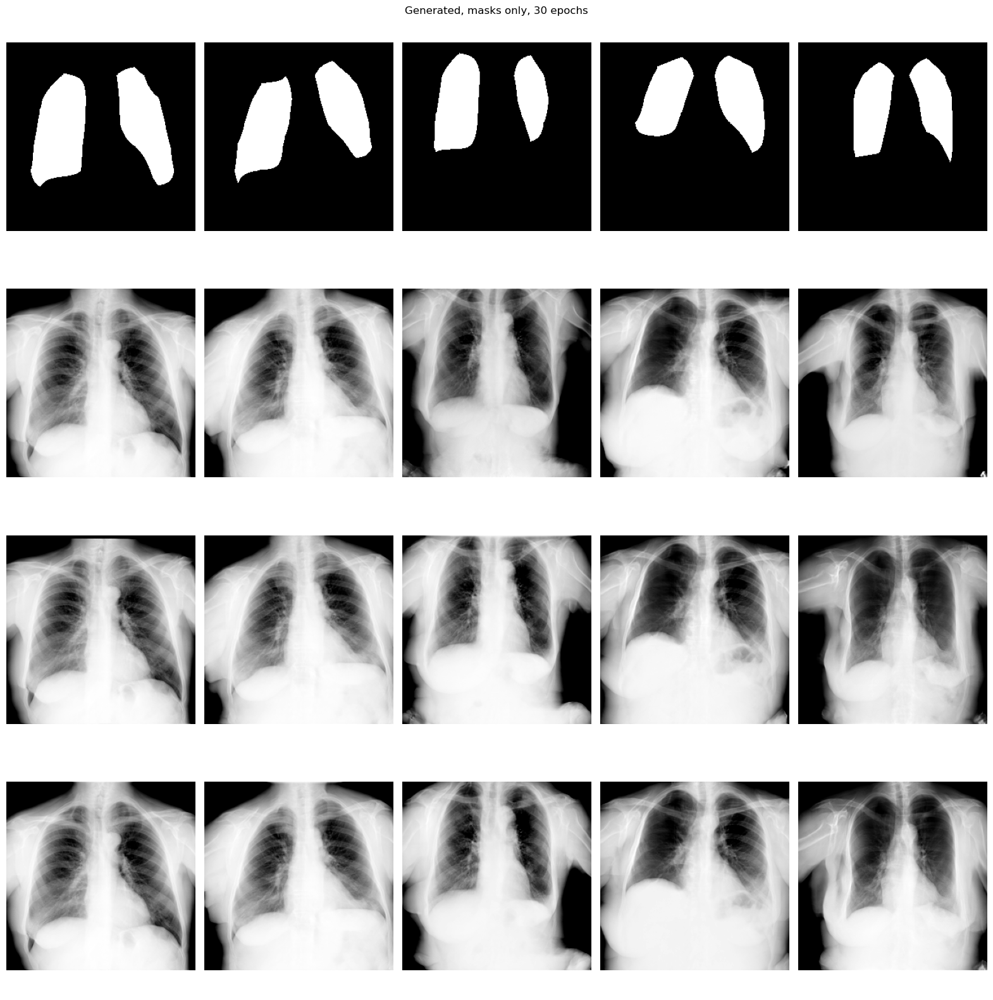

In [76]:
gen_and_show(model, epochs = epochs, gen_type = 'only_seg')

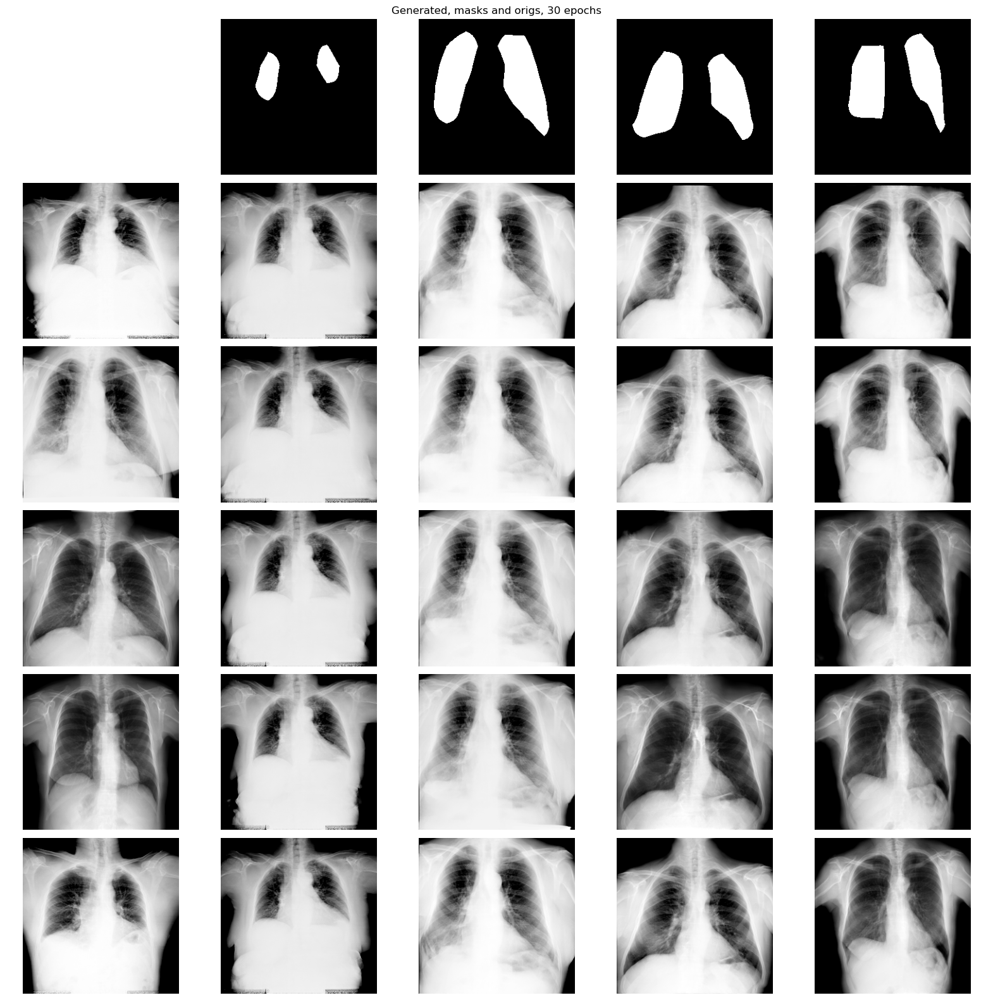

In [77]:
gen_and_show(model, epochs = epochs, gen_type = 'seg_and_real')

In [ ]:
fid_ = calculate_fid(model, n_images = len(dataset), gen_type = 'only_seg', rearrange = True, batch_size=32)

In [79]:
print(fid_)

12.407151586594438


In [ ]:
fid_ = calculate_fid(model, n_images = len(dataset), gen_type = 'seg_and_real', rearrange = False, batch_size=32)

In [83]:
print(fid_)

12.750342597296026


# 40 epochs

In [84]:
epochs = 40
load_model(model, epoch = epochs)

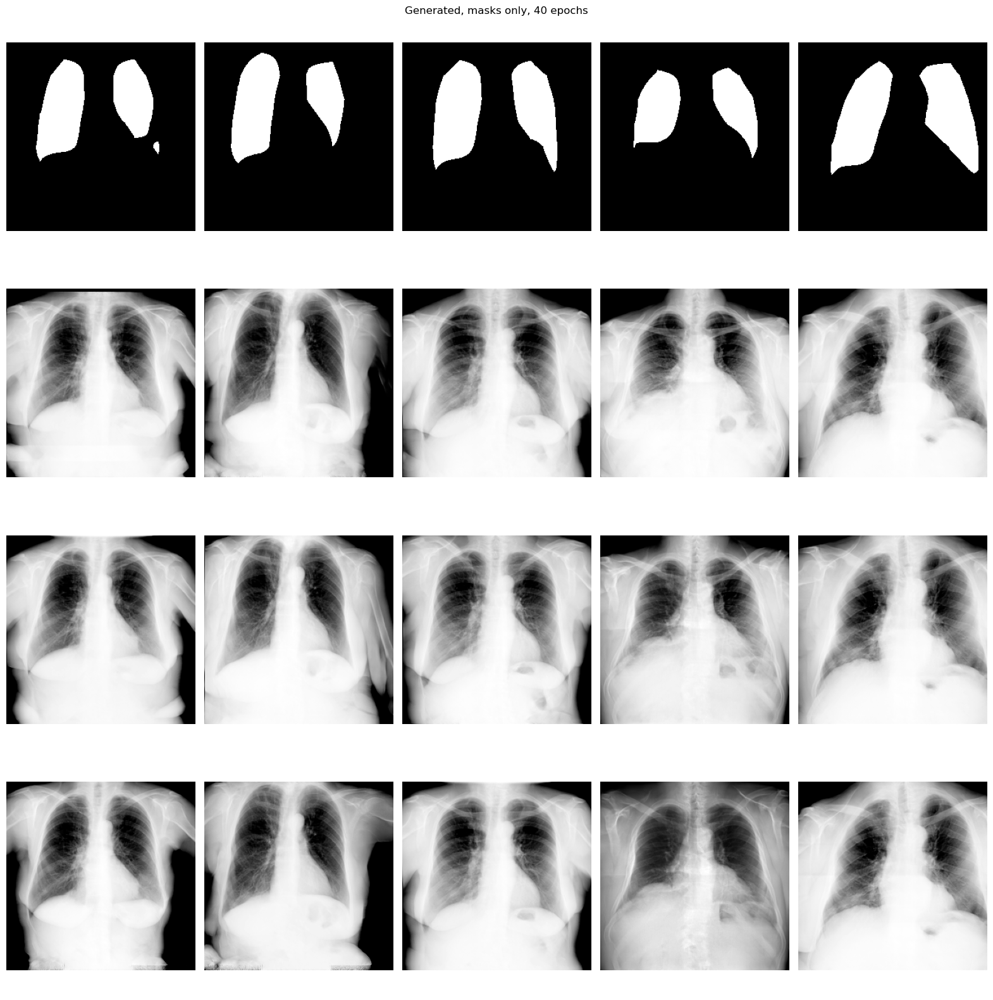

In [85]:
gen_and_show(model, epochs = epochs, gen_type = 'only_seg')

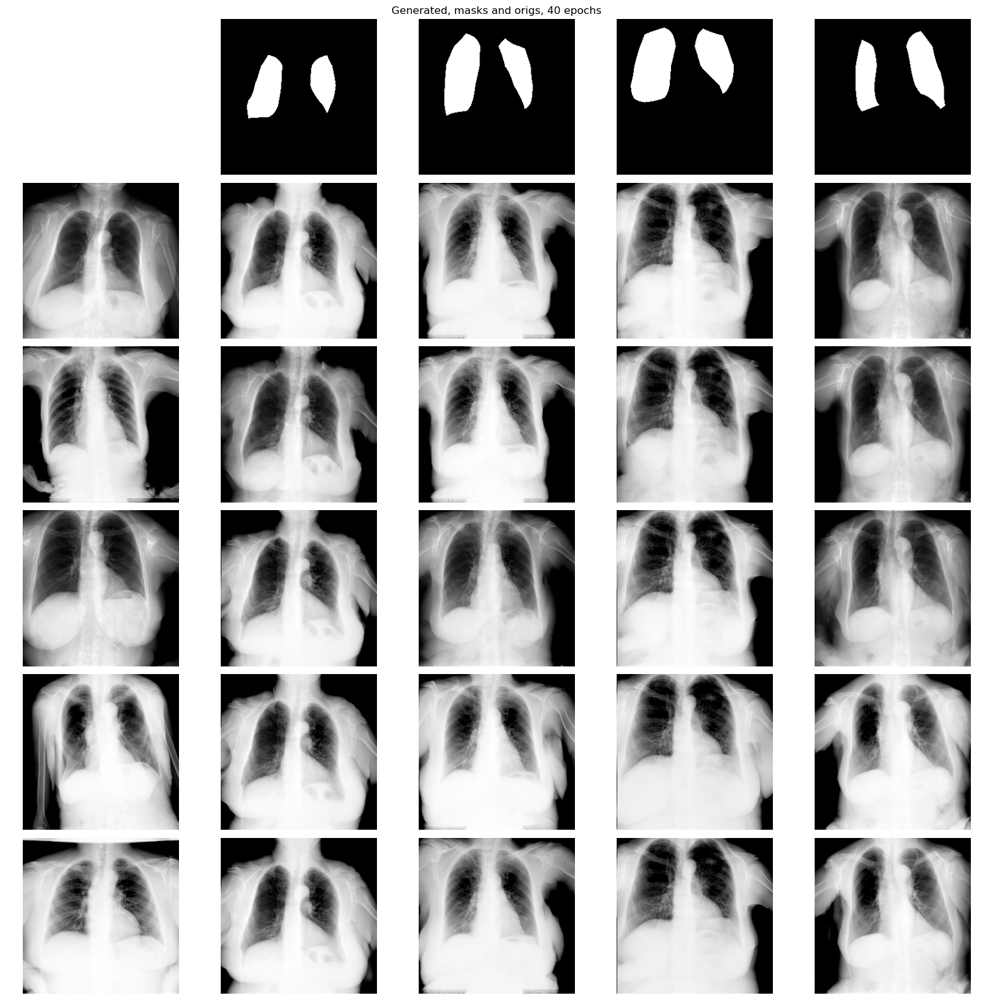

In [86]:
gen_and_show(model, epochs = epochs, gen_type = 'seg_and_real')

In [ ]:
fid_ = calculate_fid(model, n_images = len(dataset), gen_type = 'only_seg', rearrange = True, batch_size=32)

In [6]:
print(fid_)

10.140185810808646


In [ ]:
fid_ = calculate_fid(model, n_images = len(dataset), gen_type = 'seg_and_real', rearrange = True, batch_size=32)

In [8]:
print(fid_)

9.688616475162917


# 50 epochs

In [89]:
epochs = 50
load_model(model, epoch = epochs)

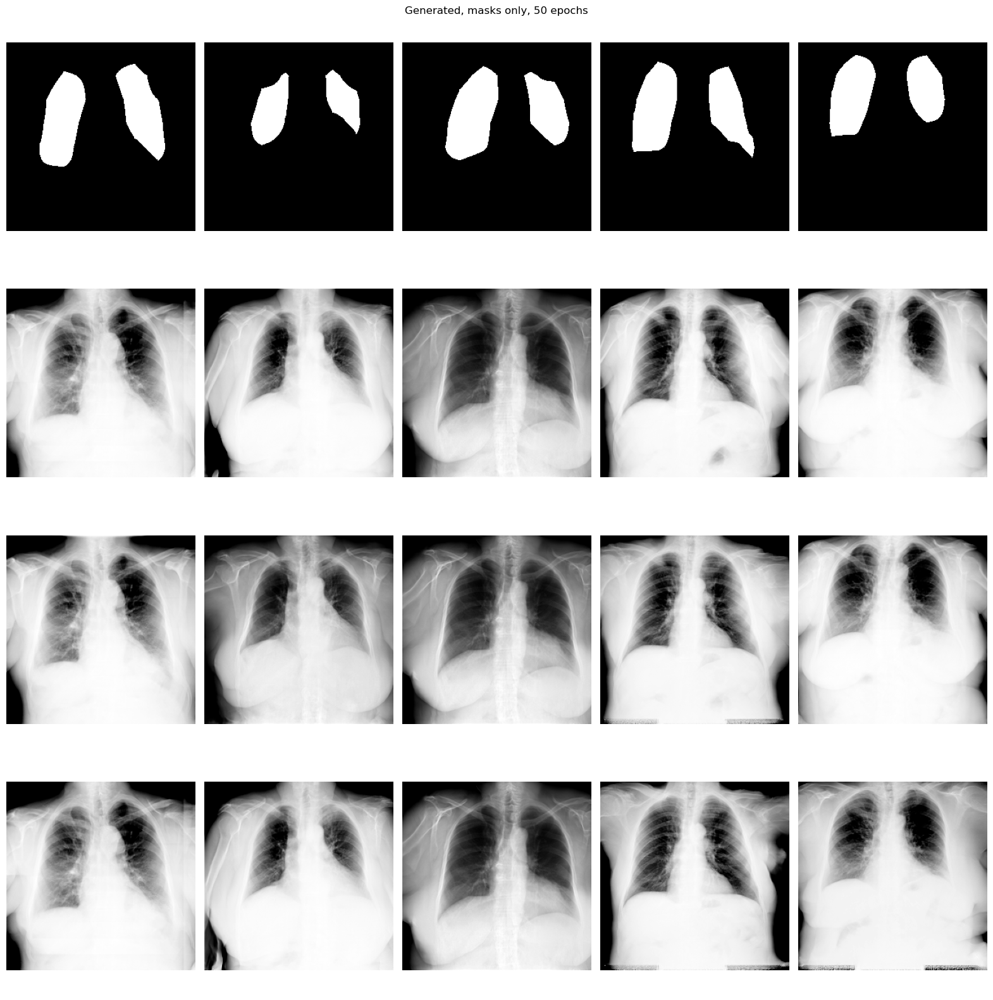

In [90]:
gen_and_show(model, epochs = epochs, gen_type = 'only_seg')

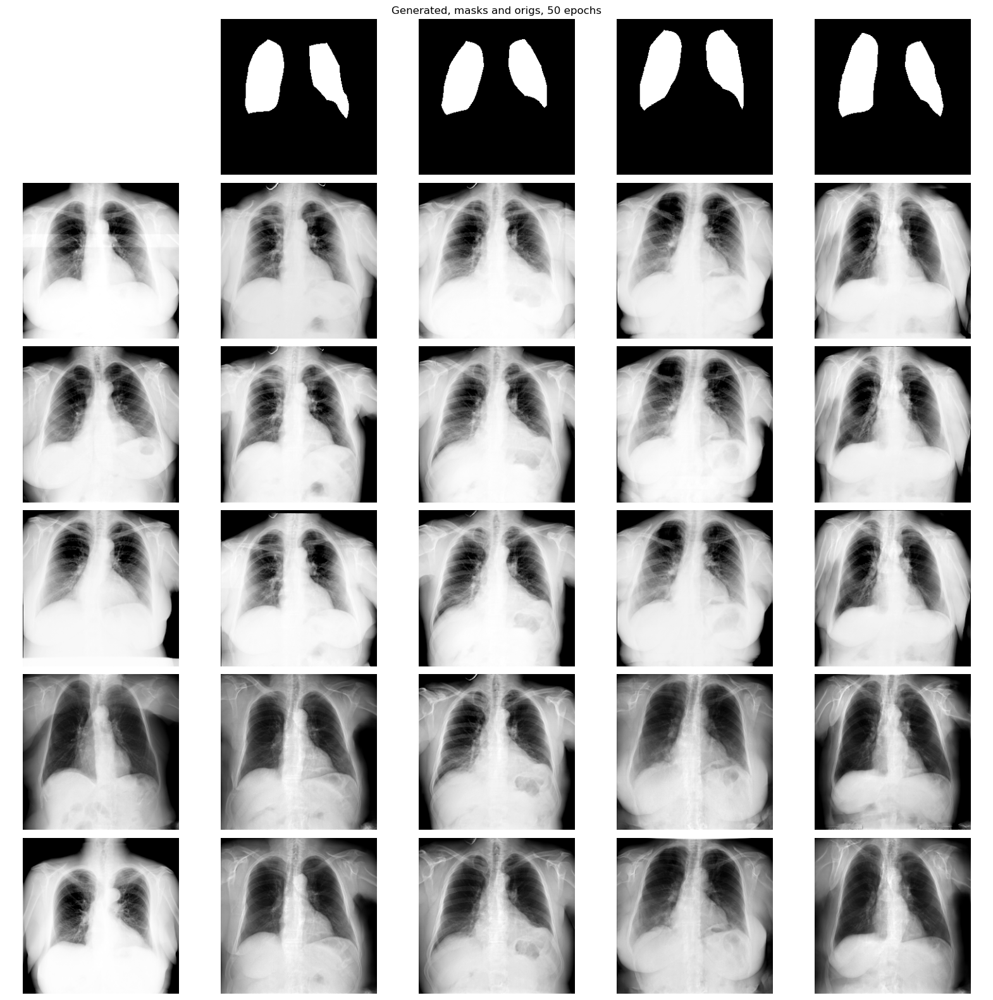

In [91]:
gen_and_show(model, epochs = epochs, gen_type = 'seg_and_real')

In [ ]:
fid_ = calculate_fid(model, n_images = len(dataset), gen_type = 'only_seg', rearrange = True, batch_size=32)

In [4]:
print(fid_)

9.014249135699487


In [ ]:
fid_ = calculate_fid(model, n_images = len(dataset), gen_type = 'seg_and_real', rearrange = True, batch_size=32)

In [2]:
print(fid_)

8.483690078102882


# 60 epochs

In [94]:
epochs = 60
load_model(model, epoch = epochs)

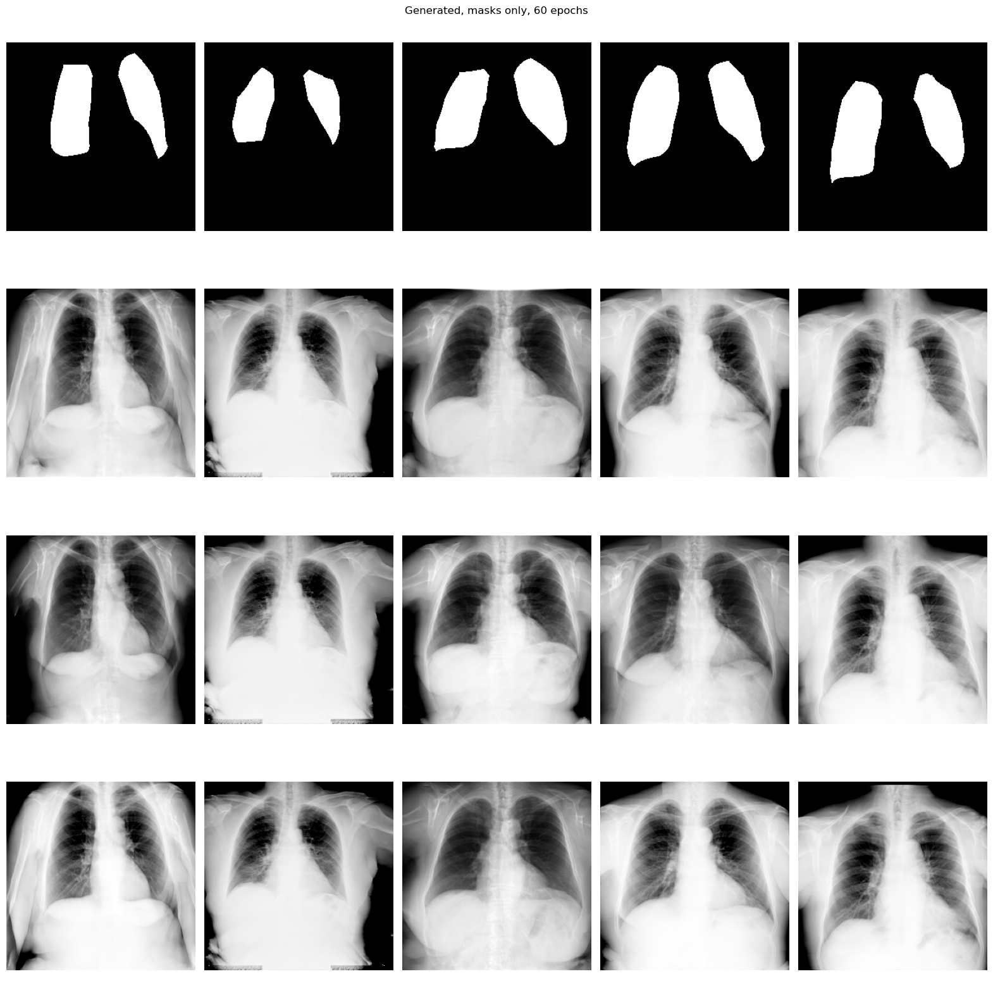

In [95]:
gen_and_show(model, epochs = epochs, gen_type = 'only_seg')

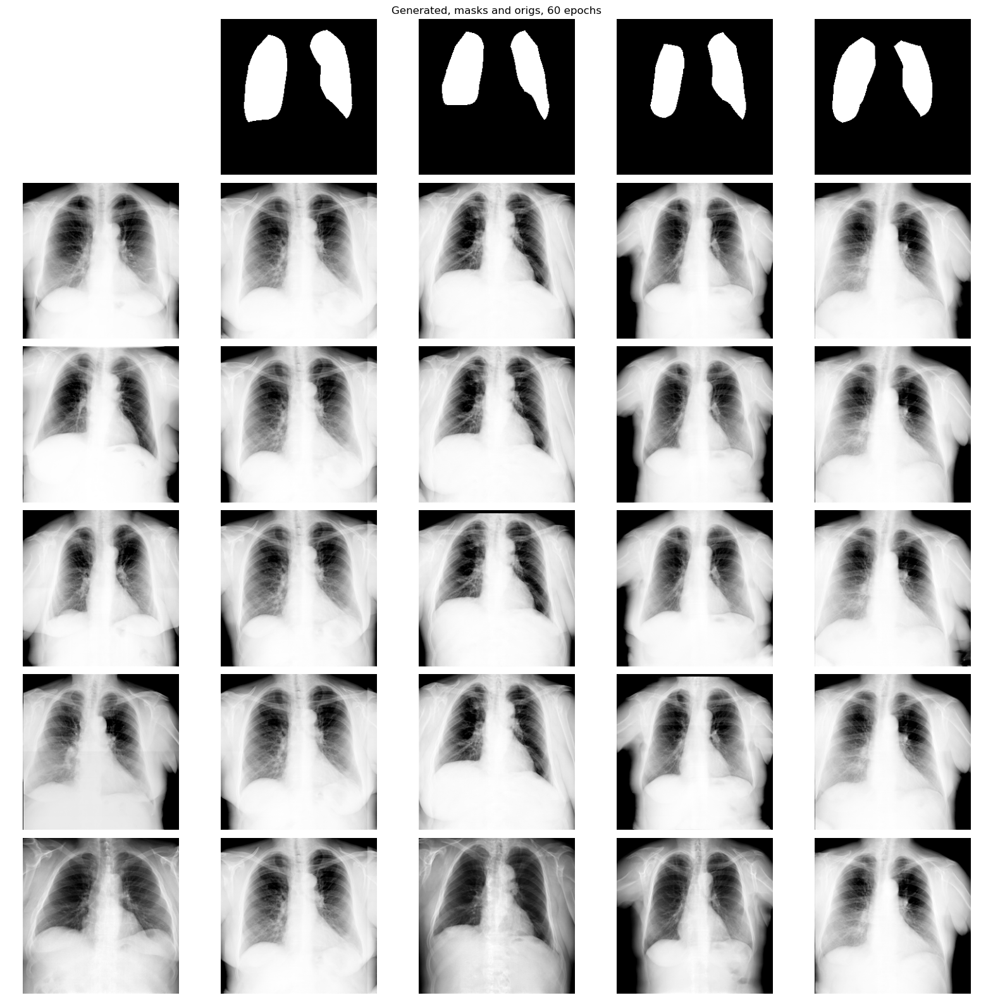

In [96]:
gen_and_show(model, epochs = epochs, gen_type = 'seg_and_real')

In [ ]:
fid_ = calculate_fid(model, n_images = len(dataset), gen_type = 'only_seg', rearrange = True, batch_size=32)

In [10]:
print(fid_)

9.298992247492293


In [ ]:
fid_ = calculate_fid(model, n_images = len(dataset), gen_type = 'seg_and_real', rearrange = True, batch_size=32)

In [12]:
print(fid_)

9.199250128478695


# 70 epochs

In [99]:
epochs = 70
load_model(model, epoch = epochs)

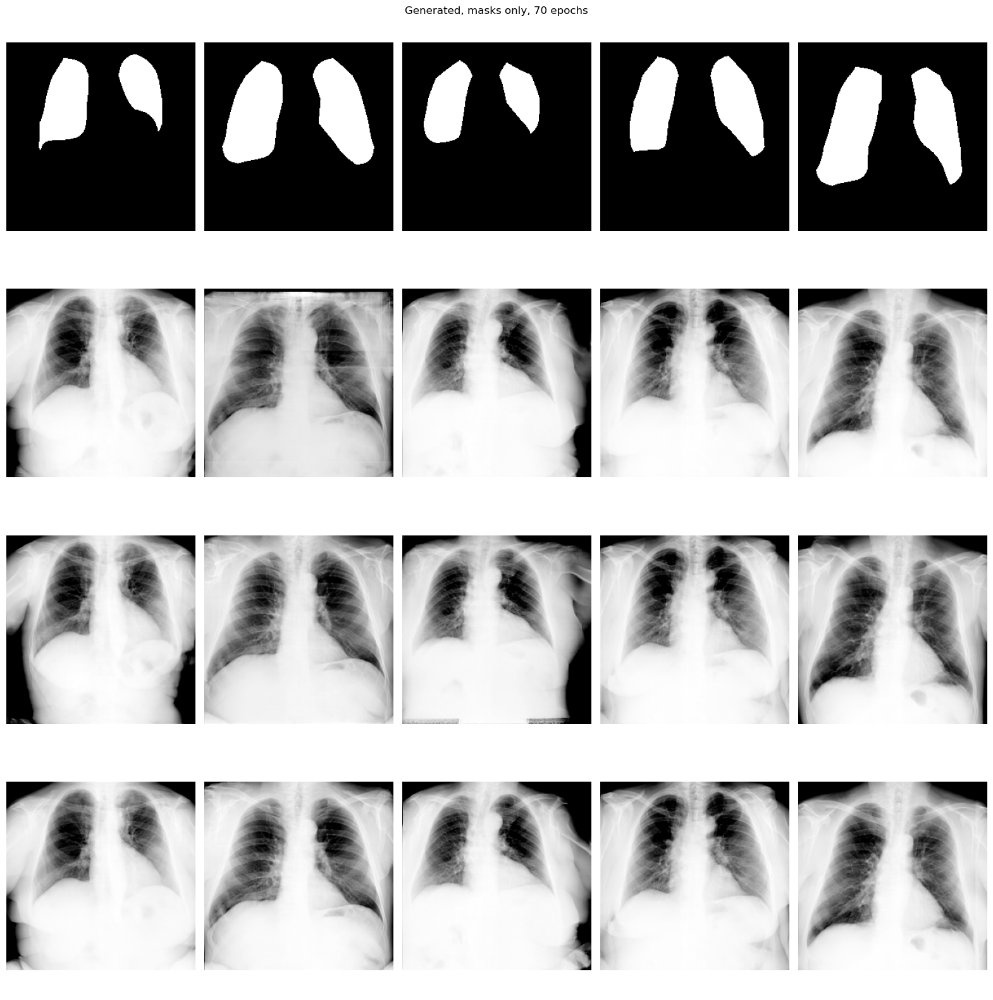

In [100]:
gen_and_show(model, epochs = epochs, gen_type = 'only_seg')

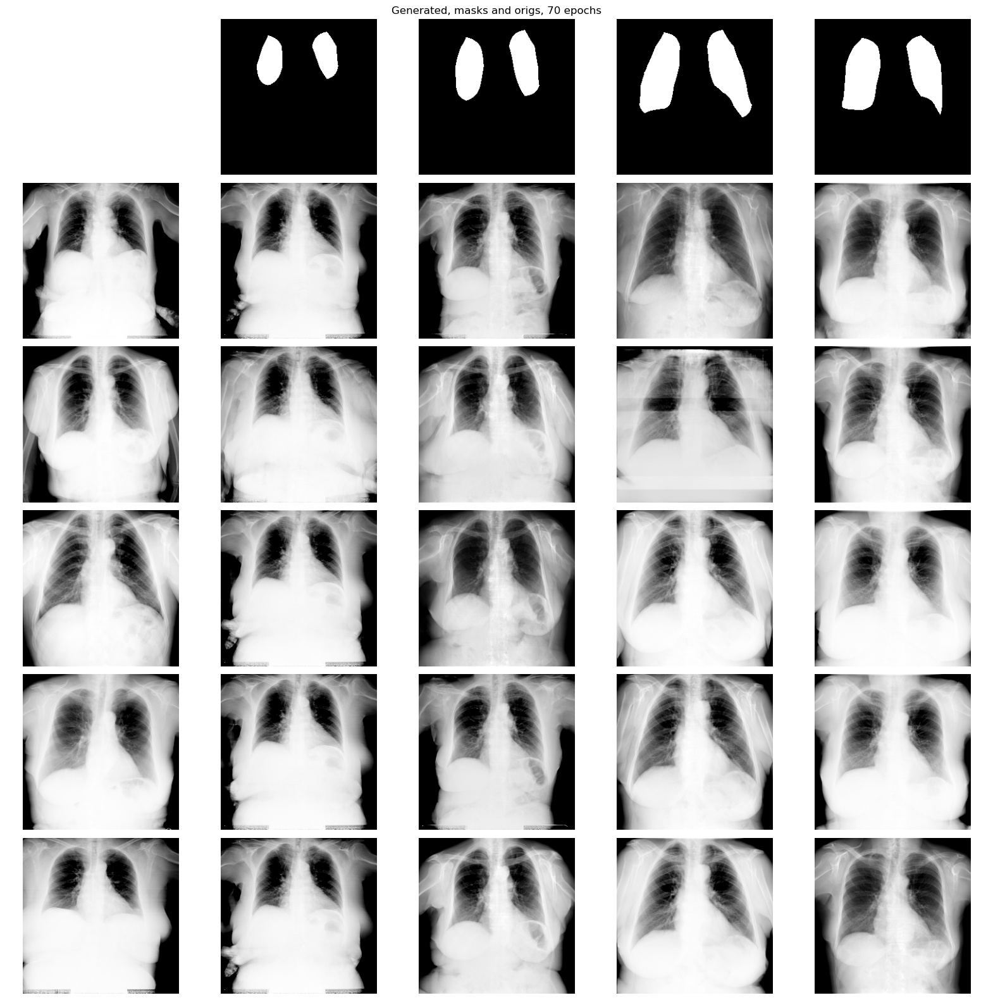

In [101]:
gen_and_show(model, epochs = epochs, gen_type = 'seg_and_real')

In [ ]:
fid_ = calculate_fid(model, n_images = len(dataset), gen_type = 'only_seg', rearrange = True, batch_size=32)

In [14]:
print(fid_)

9.277109304728924


In [ ]:
fid_ = calculate_fid(model, n_images = len(dataset), gen_type = 'seg_and_real', rearrange = True, batch_size=32)

In [16]:
print(fid_)

9.193758442787754


# 80 epochs

In [104]:
epochs = 80
load_model(model, epoch = epochs)

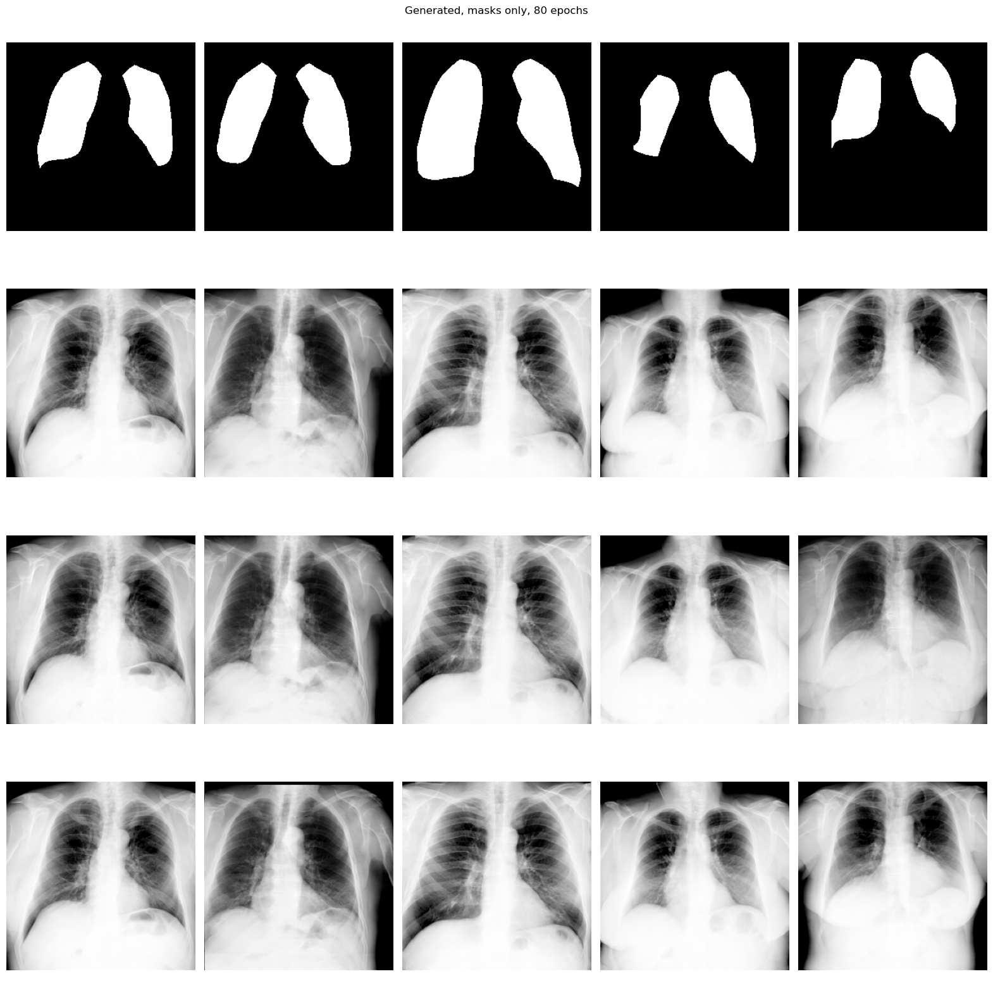

In [105]:
gen_and_show(model, epochs = epochs, gen_type = 'only_seg')

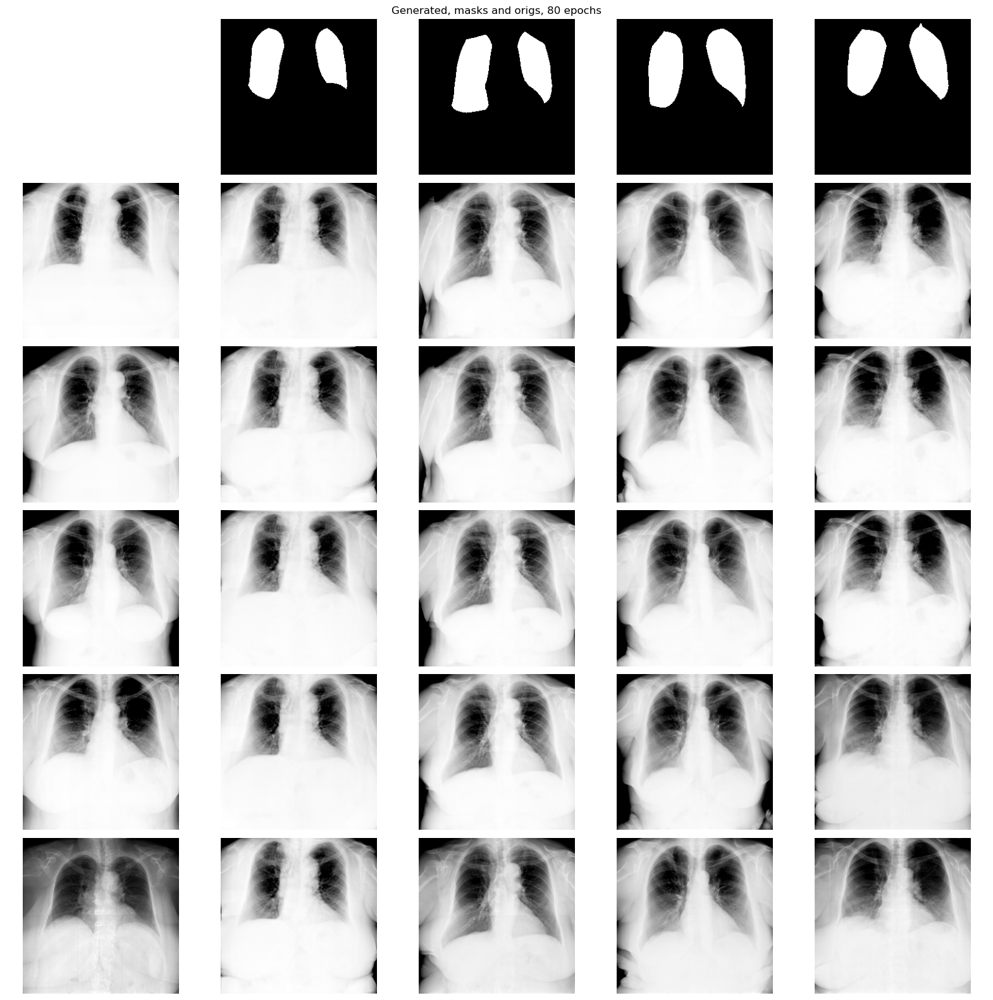

In [106]:
gen_and_show(model, epochs = epochs, gen_type = 'seg_and_real')

In [ ]:
fid_ = calculate_fid(model, n_images = len(dataset), gen_type = 'only_seg', rearrange = True, batch_size=32)
print(fid_)

In [18]:
print(fid_)

7.2723179989180835


In [ ]:
fid_ = calculate_fid(model, n_images = len(dataset), gen_type = 'seg_and_real', rearrange = True, batch_size=32)

In [20]:
print(fid_)

7.404374570092585
